In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '2'
import sys
from pathlib import Path
import anndata as ad
import numpy as np
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import seaborn as sns
from matplotlib import pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib import style
from tqdm import tqdm
style.use('seaborn-white')
os.system('/usr/bin/Xvfb :99 -screen 0 1024x768x24 &')
os.environ['DISPLAY'] = ':99'

%load_ext autoreload
%autoreload 2

(EE) 
Fatal server error:
(EE) Server is already active for display 99
	If this server is no longer running, remove /tmp/.X99-lock
	and start again.
(EE) 


In [258]:
sys.path.insert(0, "/data/suhzhang/BiologyProgram/morpho")
import morpho
sys.path.insert(0, "/data/suhzhang/BiologyProgram/spateo-release2")
import spateo_dev as st_dev

sys.path.insert(0, "../../scripts/")
from my_paste import paste_align, paste_align_RT, paste_align_ref
from my_paste2 import paste2_align, paste2_align_RT, paste2_align_ref
from my_tangram import tangram_mapping
from my_pamona import pamona_mapping

from utils import *

## Load two slices of mouse embryo 11.5

In [3]:
data_folder = "../../datasets/Mouse_embory_11.5/cellbin_coord_h5ad_cpr/"
import os
dirs = os.listdir(data_folder)
files = []
for dir in dirs:
    if os.path.splitext(dir)[1] == ".h5ad":
        files.append(dir)
def extract_number(filename):
    return int(filename.split("_")[0])
sorted_files = sorted(files, key=extract_number)
files = sorted_files

In [4]:
palette = np.load('./generated_models/MouseEmbryo_11.5_palette.npy',allow_pickle=True).item()

In [21]:
index = 35
slice1 = ad.read_h5ad(os.path.join(data_folder, files[index]))
slice2 = ad.read_h5ad(os.path.join(data_folder, files[index+1]))
slice1.obsm['spatial_2D'] = slice1.obsm['spatial'][:,:2]
slice2.obsm['spatial_2D'] = slice2.obsm['spatial'][:,:2]
slice1, slice2

(AnnData object with n_obs × n_vars = 89577 × 26482
     obs: 'ctype_user'
     uns: '__type', 'pp', 'spatial'
     obsm: 'spatial', 'spatial_regis', 'spatial_2D',
 AnnData object with n_obs × n_vars = 106545 × 26992
     obs: 'ctype_user'
     uns: '__type', 'pp', 'spatial'
     obsm: 'spatial', 'spatial_regis', 'spatial_2D')

## Add rotation

In [272]:
rigid_transformation(
    slice2, 
    'spatial_2D', 
    'rotated_spatial_2D', 
    theta=np.pi*60/180,
    fix_mean=True,
    translation=None,
)
slice1.obsm['rotated_spatial_2D'] = slice1.obsm['spatial_2D']

## Plot the two slices

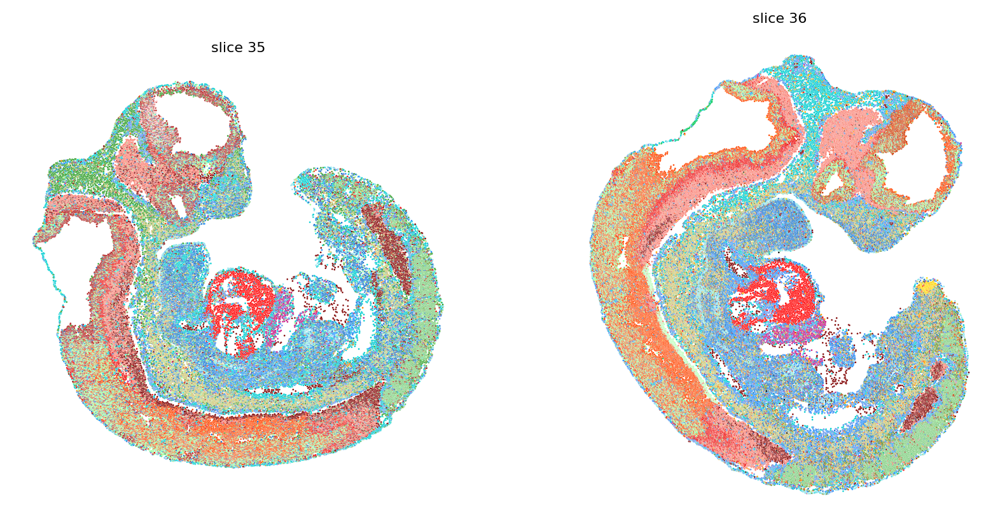

In [273]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
plot_clusters(
    slice1, 
    'rotated_spatial_2D',
    'ctype_user',
    axs[0],
    point_size=1,
    n_sampling = -1,
    palette = palette,
    title = "slice {}".format(index),
    legend=False,
    axis_off=True,
    ticks_off=True,
    background_color=None,
)
plot_clusters(
    slice2, 
    'rotated_spatial_2D',
    'ctype_user',
    axs[1],
    point_size=1,
    n_sampling = -1,
    palette = palette,
    title = "slice {}".format(index+1),
    legend=False,
    axis_off=True,
    ticks_off=True,
    background_color=None,
)
plt.show()

## PCA reduction

In [ ]:
slice1_pca, slice2_pca = PCA_reduction(
    adatas=[slice1, slice2],
    n_top_genes=2000,
    n_comps=100,
)

In [274]:
slice1_pca.obsm['rotated_spatial_2D'] = slice1.obsm['rotated_spatial_2D']
slice2_pca.obsm['rotated_spatial_2D'] = slice2.obsm['rotated_spatial_2D']

In [420]:
align_slices, align_slices_ref, morpho_pis, _, _ = st_dev.align.morpho_align_ref(
    models=[slice1_pca.copy(), slice2_pca.copy()],
    spatial_key="rotated_spatial_2D",
    key_added="align_spatial",
    device="2",
    mode="SN-S",
    dissimilarity="euc",
    max_iter=200,
    verbose=True,
    partial_robust_level=25,
    beta=1e-1,
    beta2=0.1,
    beta2_end=2,
    lambdaVF=1e1,
    SVI_mode=True,
    n_sampling=20000,
    sampling_method="random",
    nn_init=False,
)

|-----> [Models alignment with ref-models based on morpho, mode: SN-S.] in progress: 100.0000%|-----> Filtered all samples for common genes. There are 100 common genes.
|-----> Coordinates normalization params:
|-----------> Scale: 3585.731201171875.
|-----> Gene expression normalization params:
|-----------> Scale: 11.278580665588379.
beta2: 0.10000000149011612 --> 2.0
|-----> [Start morpho alignment] in progress: 100.0000%
|-----> [Start morpho alignment] finished [15.6880s]
|-----> Key Parameters: gamma: 0.931389331817627; beta2: 2.0; sigma2: 0.004141075070947409
|-----> [Models alignment with ref-models based on morpho, mode: SN-S.] in progress: 100.0000%
|-----> [Models alignment with ref-models based on morpho, mode: SN-S.] finished [1.8236s]


In [263]:
align_slices_ref[1]

AnnData object with n_obs × n_vars = 20000 × 100
    obs: 'ctype_user'
    uns: 'iter_spatial', 'VecFld_morpho'
    obsm: 'spatial', 'spatial_regis', 'spatial_2D', 'rotated_spatial_2D', 'align_spatial', 'align_spatial_rigid', 'align_spatial_nonrigid'

In [280]:
two_d_pairwise_animate(
    model_ref=align_slices_ref[0],
    model=align_slices_ref[1],
    spatial_key="rotated_spatial_2D",
    key_added="align_spatial",
    filename="./figures/visualization2D",
    stepsize=4,
)

MovieWriter ffmpeg unavailable; using Pillow instead.


In [283]:
align_slices[0]

AnnData object with n_obs × n_vars = 89577 × 100
    obs: 'ctype_user'
    obsm: 'spatial', 'spatial_regis', 'spatial_2D', 'rotated_spatial_2D', 'align_spatial', 'align_spatial_rigid', 'align_spatial_nonrigid'

In [61]:
align_slices[1]

AnnData object with n_obs × n_vars = 106545 × 100
    obs: 'ctype_user'
    uns: 'VecFld_morpho'
    obsm: 'spatial', 'spatial_regis', 'spatial_2D', 'rotated_spatial_2D', 'align_spatial', 'align_spatial_rigid', 'align_spatial_nonrigid'

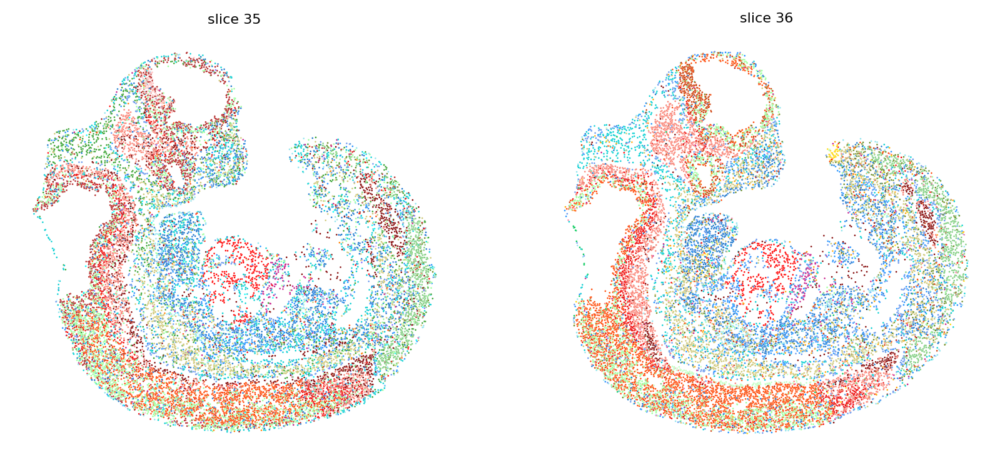

In [286]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
plot_clusters(
    align_slices_ref[0], 
    'align_spatial_rigid',
    'ctype_user',
    axs[0],
    point_size=1,
    n_sampling = -1,
    palette = palette,
    title = "slice {}".format(index),
    legend=False,
    axis_off=True,
    ticks_off=True,
    background_color=None,
)
plot_clusters(
    align_slices_ref[1], 
    'align_spatial_rigid',
    'ctype_user',
    axs[1],
    point_size=1,
    n_sampling = -1,
    palette = palette,
    title = "slice {}".format(index+1),
    legend=False,
    axis_off=True,
    ticks_off=True,
    background_color=None,
)
plt.show()

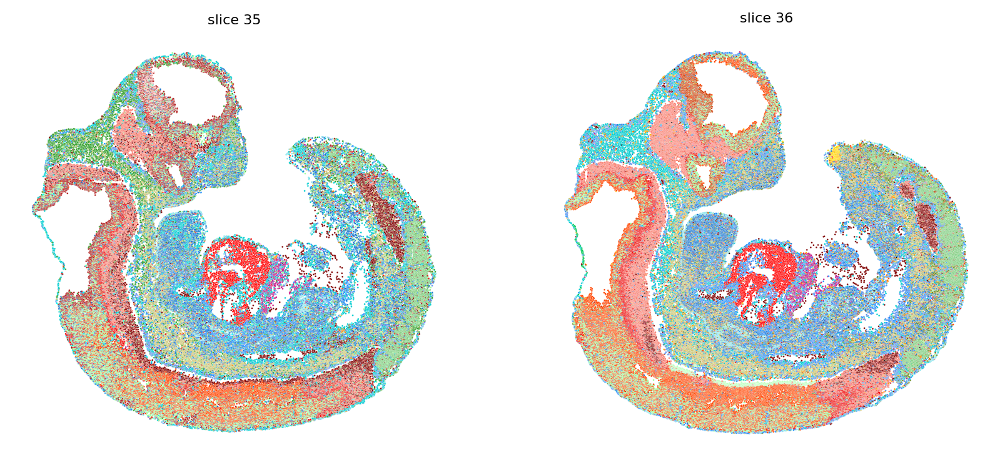

In [290]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
plot_clusters(
    align_slices[0], 
    'align_spatial_rigid',
    'ctype_user',
    axs[0],
    point_size=1,
    n_sampling = -1,
    palette = palette,
    title = "slice {}".format(index),
    legend=False,
    axis_off=True,
    ticks_off=True,
    background_color=None,
)
plot_clusters(
    align_slices[1], 
    'align_spatial_rigid',
    'ctype_user',
    axs[1],
    point_size=1,
    n_sampling = -1,
    palette = palette,
    title = "slice {}".format(index+1),
    legend=False,
    axis_off=True,
    ticks_off=True,
    background_color=None,
)
plt.show()

In [143]:
randIdx

array([ 3453,  5029, 17008, ...,  2503,  2744, 10776])

In [207]:
align_slices[1].uns['VecFld_morpho']['intermediate_results']['sigma2']

array(0.37343958, dtype=float32)

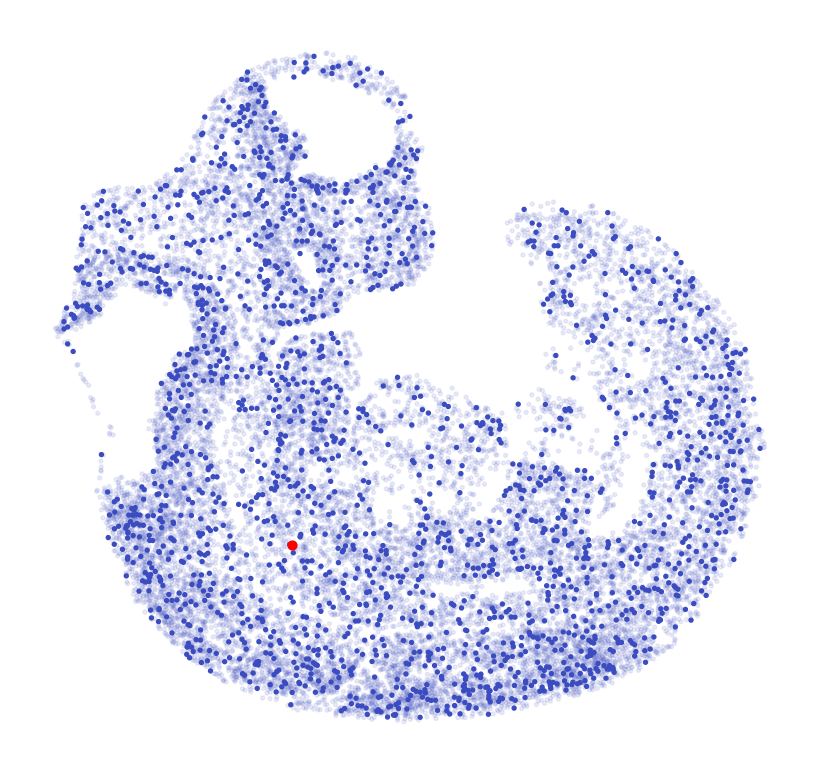

In [421]:
inter_P = align_slices[1].uns['VecFld_morpho']['intermediate_results']['P']
XAHat = align_slices[1].uns['VecFld_morpho']['intermediate_results']['XAHat']
randcoordsB = align_slices[1].uns['VecFld_morpho']['intermediate_results']['randcoordsB']
randIdx = align_slices[1].uns['VecFld_morpho']['intermediate_results']['randIdx'].numpy()
alpha = align_slices[1].uns['VecFld_morpho']['intermediate_results']['alpha']
R = align_slices[1].uns['VecFld_morpho']['intermediate_results']['R']
sigma2 = align_slices[1].uns['VecFld_morpho']['intermediate_results']['sigma2']



fig, ax = plt.subplots(1,1,figsize=(5,5))
# select_indexs = [1300, 1400, 1100, 1700, 1110]
# select_index = 1300
select_indexs = [1300]
select_scalar = np.zeros((randcoordsB.shape[0],))
select_scalar[select_index] = 0.1
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][:,0],align_slices_ref[0].obsm['rotated_spatial_2D'][:,1], s=2, c=np.zeros((align_slices_ref[0].shape[0],)),alpha=0.1, cmap='coolwarm',vmin=0,vmax=1)
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,1], s=2, c=np.zeros((randIdx.shape[0],)), cmap='coolwarm',vmin=0,vmax=1)
# ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')
for select_index in select_indexs:
    ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
# plt.savefig('./figures/datapoints_batch.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

In [408]:
plot_scalar.max()

2.0006482633997535

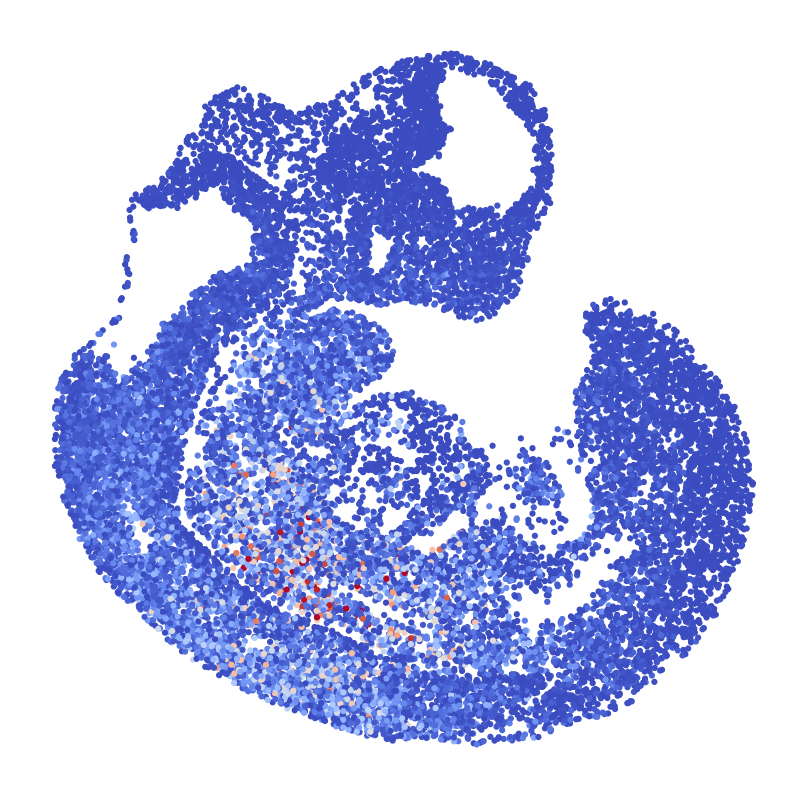

In [423]:
fig, ax = plt.subplots(1,1,figsize=(5,5))

plot_scalar = np.zeros((inter_P.shape[0],))
for select_index in select_indexs:
    cur_scalar = inter_P[:,select_index] / -np.sort(-inter_P[:,select_index])[30]
    cur_scalar = np.minimum(cur_scalar,1)
    plot_scalar += cur_scalar
# plot_scalar = morpho_pis[0][select_index,:]
plot_sort = np.argsort(plot_scalar)
ax.scatter(align_slices_ref[1].obsm['align_spatial'][:,0],align_slices_ref[1].obsm['align_spatial'][:,1], s=3, c=plot_scalar, cmap='coolwarm', vmin=0, vmax=np.max(plot_scalar))

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
# plt.savefig('./figures/modelpoints.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

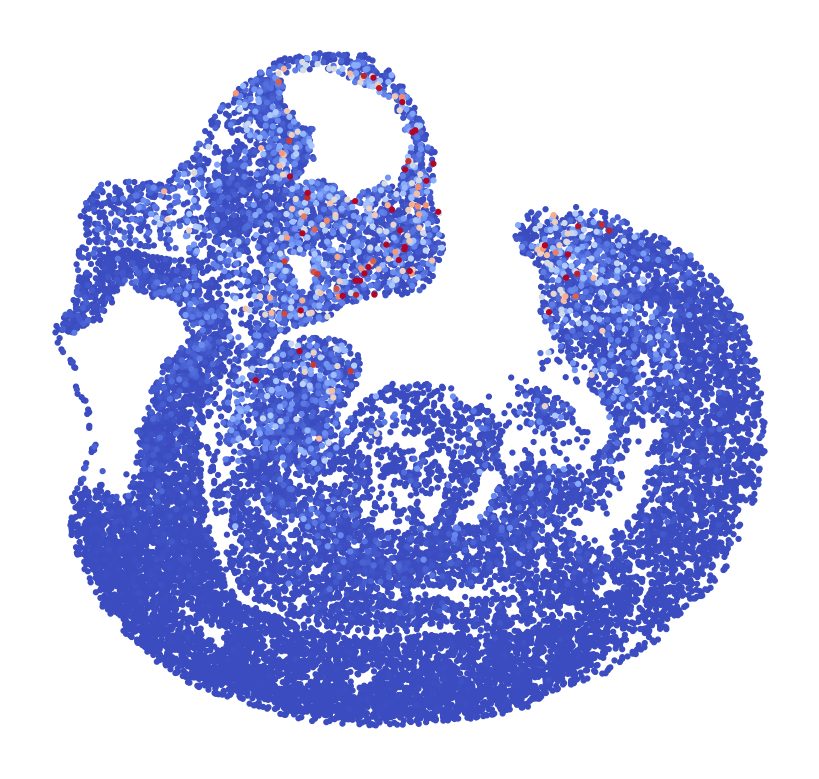

In [209]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
plot_sort = np.argsort(inter_P[:,select_index])
ax.scatter(XAHat[plot_sort,0],XAHat[plot_sort,1], s=3, c=inter_P[plot_sort,select_index], cmap='coolwarm', vmin=0, vmax=-np.sort(-inter_P[:,select_index])[30])

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
# plt.savefig('./figures/modelpoints.png', dpi=600, bbox_inches='tight', transparent=True)

In [300]:
alpha

array([2.9433468e-05, 2.7517181e-05, 2.8599592e-05, ..., 3.0836625e-05,
       2.9608638e-05, 3.0956871e-05], dtype=float32)

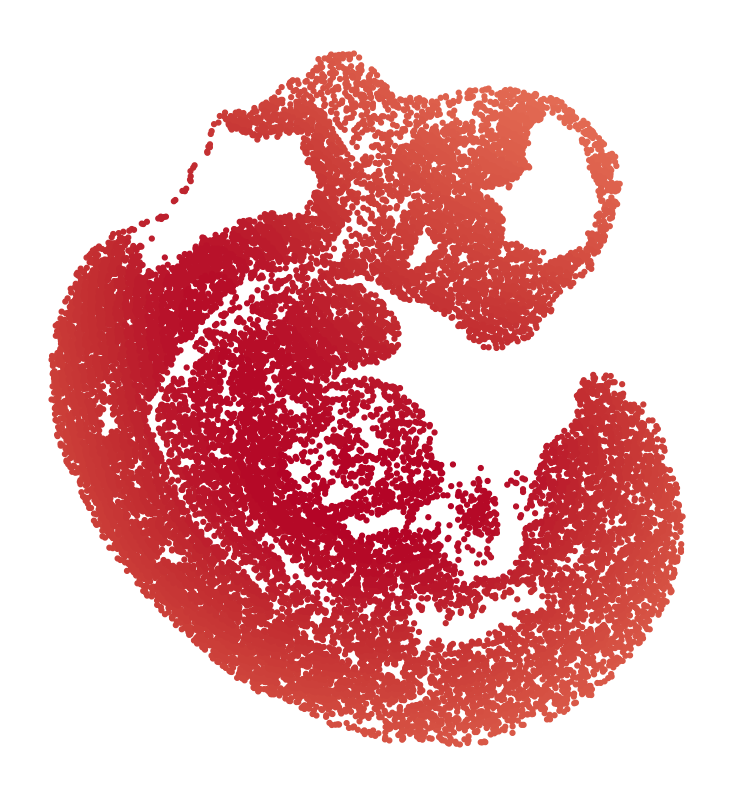

In [317]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
plot_sort = np.argsort(alpha)
ax.scatter(XAHat[plot_sort,0],XAHat[plot_sort,1], s=3, c=alpha[plot_sort], cmap='coolwarm', vmin=0)

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
plt.savefig('./figures/alpha.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

In [301]:
inter_P.shape

(20000, 2000)

In [305]:
np.sum(inter_P,0).max()

0.9999544

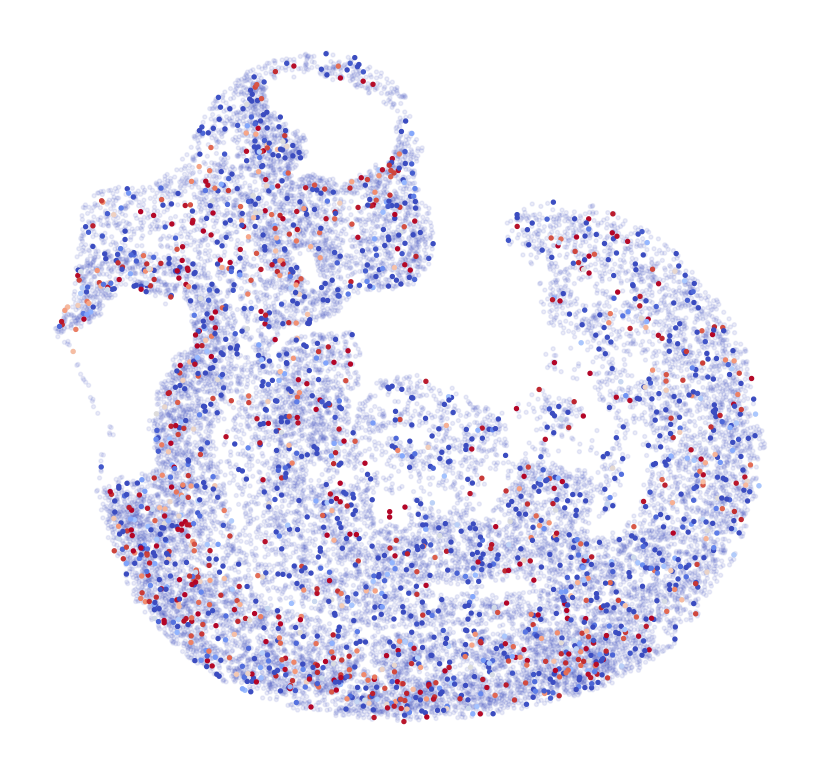

In [318]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][:,0],align_slices_ref[0].obsm['rotated_spatial_2D'][:,1], s=2, c=np.zeros((align_slices_ref[0].shape[0],)),alpha=0.1, cmap='coolwarm',vmin=0,vmax=1)
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,1], s=2, c=np.sum(inter_P,0), cmap='coolwarm',vmin=0,vmax=1)
# ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
plt.savefig('./figures/gamma.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

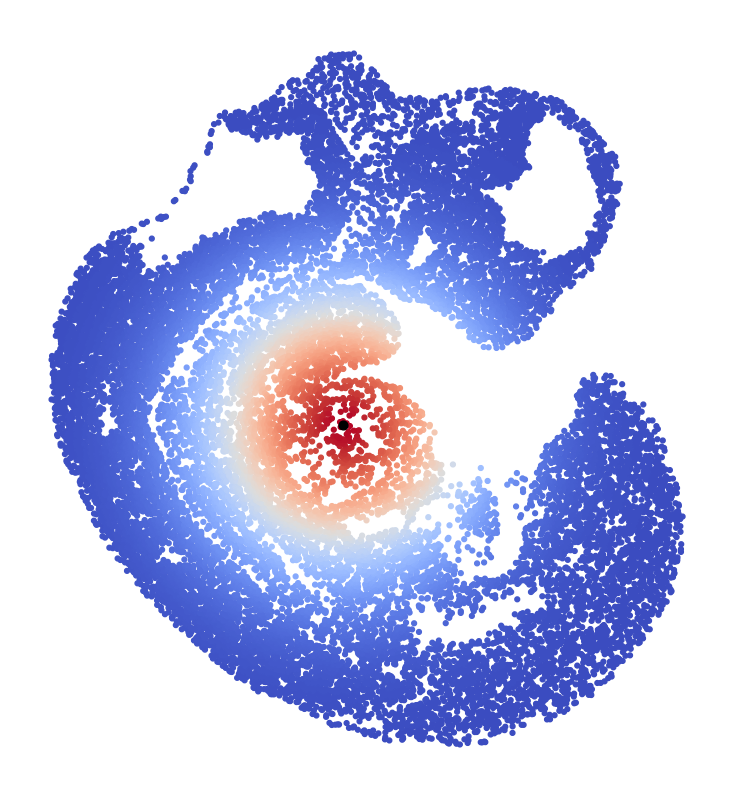

In [319]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
XAHat_mean = np.mean(XAHat, 0)
dist = np.sqrt(np.sum((XAHat - XAHat_mean)**2, 1))
scale = np.sqrt(np.sum((XAHat - XAHat_mean)**2) / XAHat.shape[0])
sigma_field = np.exp(-dist**2 / (scale**2 * sigma2))


plot_sort = np.argsort(sigma_field)
ax.scatter(XAHat[plot_sort,0],XAHat[plot_sort,1], s=3, c=sigma_field[plot_sort], cmap='coolwarm', vmin=0)
ax.scatter(XAHat_mean[0],XAHat_mean[1], s=10, c='k')

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
plt.savefig('./figures/sigma2.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

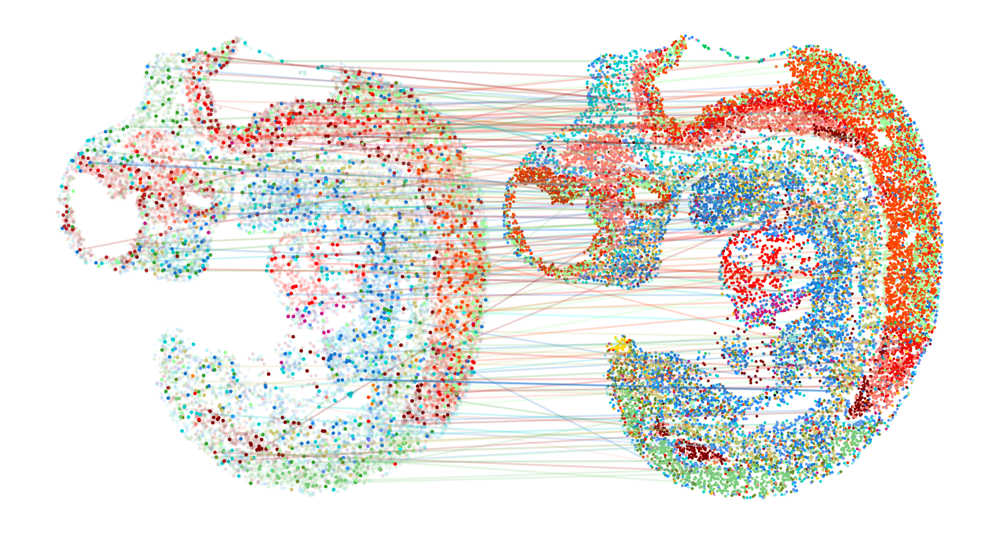

In [246]:
interval = 10000

fig, ax = plt.subplots(1,1,figsize=(10,5))

X1 = align_slices_ref[0].obsm['rotated_spatial_2D'].copy()
X1_mean = np.mean(X1)
X1 = X1 - X1_mean
theta = np.pi / 2
rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)], [np.sin(theta), np.cos(theta)]])
flip_matrix = np.array([[-1, 0], [0, 1]])
X1 = X1 @ rotation_matrix @ flip_matrix
X1 = X1 + X1_mean
# X2 = align_slices_ref[1].obsm['rotated_spatial_2D'].copy()
X2 = XAHat.copy()
X2_mean = np.mean(X2)
X2 = X2 - X2_mean
X2 = X2 @ rotation_matrix @ flip_matrix
X2 = X2 + X2_mean


label_1_ref_batch = align_slices_ref[0].obs['ctype_user'][randIdx].values
label_1_ref = align_slices_ref[0].obs['ctype_user'].values
label_2_ref = align_slices_ref[1].obs['ctype_user'].values

color_1_ref = [palette[l] for l in list(label_1_ref)]
color_2_ref = [palette[l] for l in list(label_2_ref)]
color_1_ref_batch = [palette[l] for l in list(label_1_ref_batch)]

ax.scatter(X1[:,0],X1[:,1], s=2, color=color_1_ref,alpha=0.1, )
ax.scatter(X1[randIdx,0],X1[randIdx,1], s=2, color=color_1_ref_batch, cmap='coolwarm',vmin=0,vmax=1)
# ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')
mapping = inter_P.T


# for i in range(mapping.shape[0]):
for i in np.random.choice(randIdx.shape[0], 200):
    # if np.sum(mapping[i]) < robust_threshold:
    #     continue
    mapping_idx = np.argmax(mapping[i])
    ax.plot(np.array([X1[randIdx[i],0], X2[mapping_idx,0]+interval]), np.array([X1[randIdx[i],1], X2[mapping_idx,1]]), color=palette[label_1_ref_batch[i]], linewidth=1, alpha=0.2)

ax.scatter(X2[:,0]+interval,X2[:,1], s=1, color=color_2_ref)

ax.set_facecolor('white')
ax.axis('off')
# ax.set_title(title)
ax.set_aspect('equal')
plt.savefig('./figures/mapping.png', dpi=600, bbox_inches='tight', transparent=True)

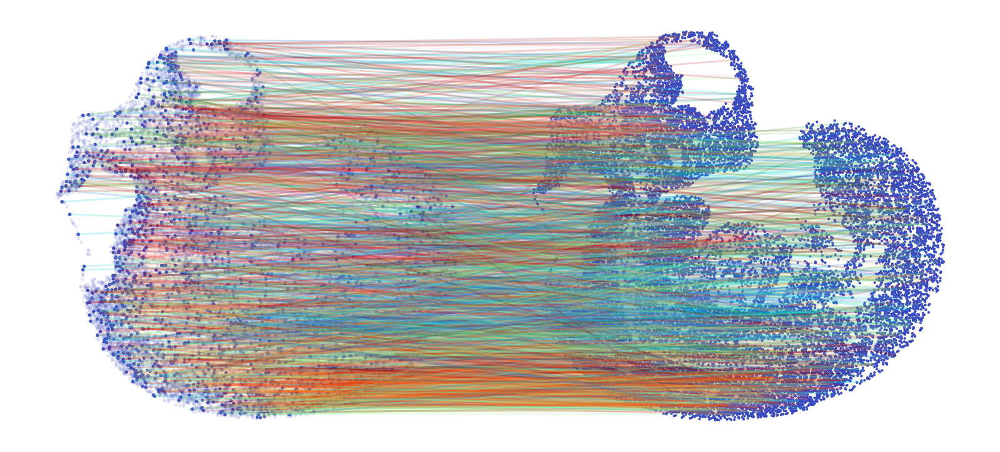

In [218]:
interval = 12000

fig, ax = plt.subplots(1,1,figsize=(10,5))
select_index = 100
select_scalar = np.zeros((randcoordsB.shape[0],))
select_scalar[select_index] = 0.1
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][:,0],align_slices_ref[0].obsm['rotated_spatial_2D'][:,1], s=2, c=np.zeros((align_slices_ref[0].shape[0],)),alpha=0.1, cmap='coolwarm',vmin=0,vmax=1)
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,1], s=2, c=np.zeros((randIdx.shape[0],)), cmap='coolwarm',vmin=0,vmax=1)
# ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')
mapping = inter_P.T
label_1_ref = align_slices_ref[0].obs['ctype_user'][randIdx].values
for i in range(mapping.shape[0]):
    # if np.sum(mapping[i]) < robust_threshold:
    #     continue
    mapping_idx = np.argmax(mapping[i])
    ax.plot(np.array([align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[i],0], XAHat[mapping_idx,0]+interval]), np.array([align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[i],1], XAHat[mapping_idx,1]]), color=palette[label_1_ref[i]], linewidth=1, alpha=0.2)

ax.scatter(XAHat[:,0]+interval,XAHat[:,1], s=1, c=np.zeros((XAHat.shape[0],)), cmap='coolwarm',vmin=0,vmax=1)

ax.set_facecolor('white')
ax.axis('off')
# ax.set_title(title)
ax.set_aspect('equal')

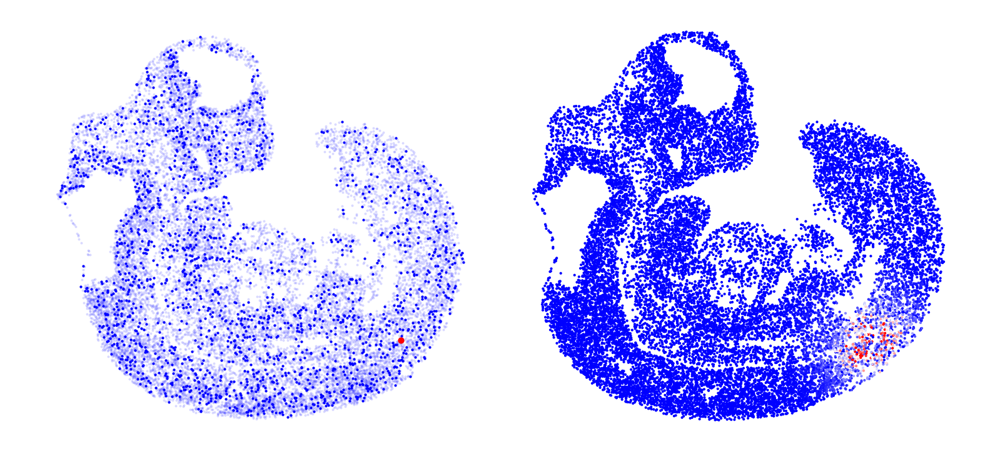

In [195]:
inter_P = align_slices[1].uns['VecFld_morpho']['intermediate_results']['P']
XAHat = align_slices[1].uns['VecFld_morpho']['intermediate_results']['XAHat']
randcoordsB = align_slices[1].uns['VecFld_morpho']['intermediate_results']['randcoordsB']
randIdx = align_slices[1].uns['VecFld_morpho']['intermediate_results']['randIdx'].numpy()

interval = 12000

fig, ax = plt.subplots(1,1,figsize=(10,5))
select_index = 1910
select_scalar = np.zeros((randcoordsB.shape[0],))
select_scalar[select_index] = 0.1
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][:,0],align_slices_ref[0].obsm['rotated_spatial_2D'][:,1], s=1, c='b',alpha=0.1)
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,1], s=1, c='b')
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')
ax.scatter(XAHat[:,0]+interval,XAHat[:,1], s=1, c=inter_P[:,select_index], cmap='bwr', vmin=0, vmax=-np.sort(-inter_P[:,select_index])[30])

ax.set_facecolor('white')
ax.axis('off')
# ax.set_title(title)
ax.set_aspect('equal')

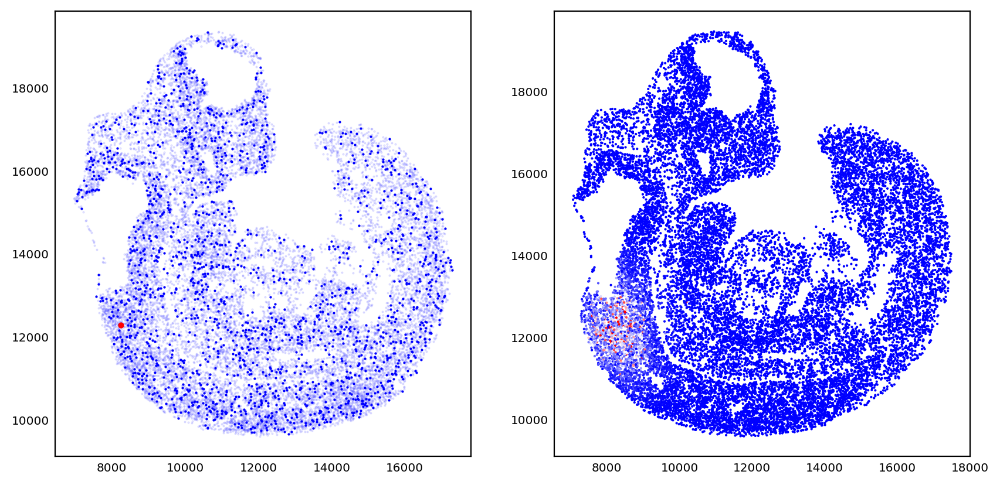

In [153]:
inter_P = align_slices[1].uns['VecFld_morpho']['intermediate_results']['P']
XAHat = align_slices[1].uns['VecFld_morpho']['intermediate_results']['XAHat']
randcoordsB = align_slices[1].uns['VecFld_morpho']['intermediate_results']['randcoordsB']
randIdx = align_slices[1].uns['VecFld_morpho']['intermediate_results']['randIdx'].numpy()

fig, axs = plt.subplots(1,2,figsize=(10,5))
select_index = 100
select_scalar = np.zeros((randcoordsB.shape[0],))
select_scalar[select_index] = 0.1
# plot_scalar_coords(
#     randcoordsB, 
#     ax=axs[0],
#     point_size=2,
#     add_scalar = select_scalar,
#     title = '',
#     palette = 'bwr',
#     legend=False,
# )
axs[0].scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][:,0],align_slices_ref[0].obsm['rotated_spatial_2D'][:,1], s=1, c='b',alpha=0.1)
axs[0].scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,1], s=1, c='b')
axs[0].scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')
axs[1].scatter(XAHat[:,0],XAHat[:,1], s=1, c=inter_P[:,select_index], cmap='bwr', vmin=0, vmax=-np.sort(-inter_P[:,select_index])[30])

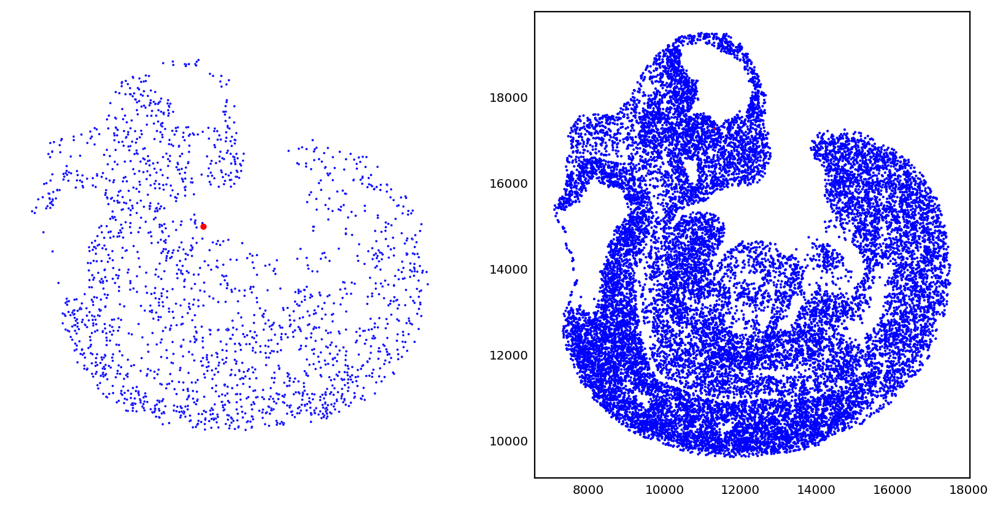

In [100]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
select_index = 100
select_scalar = np.zeros((randcoordsB.shape[0],))
select_scalar[select_index] = 0.1
plot_scalar_coords(
    randcoordsB, 
    ax=axs[0],
    point_size=2,
    add_scalar = select_scalar,
    title = '',
    palette = 'bwr',
    legend=False,
)
axs[0].scatter(randcoordsB[select_index,0],randcoordsB[select_index,1],s=10,c='r')
axs[1].scatter(XAHat[:,0],XAHat[:,1], s=1, c=inter_P[:,select_index], cmap='bwr')

In [373]:
inter_P = align_slices[1].uns['VecFld_morpho']['converge_results']['P']
XAHat = align_slices[1].uns['VecFld_morpho']['converge_results']['XAHat']
randcoordsB = align_slices[1].uns['VecFld_morpho']['converge_results']['randcoordsB']
randIdx = align_slices[1].uns['VecFld_morpho']['converge_results']['randIdx'].numpy()
alpha = align_slices[1].uns['VecFld_morpho']['converge_results']['alpha']
R = align_slices[1].uns['VecFld_morpho']['converge_results']['R']
sigma2 = align_slices[1].uns['VecFld_morpho']['converge_results']['sigma2']

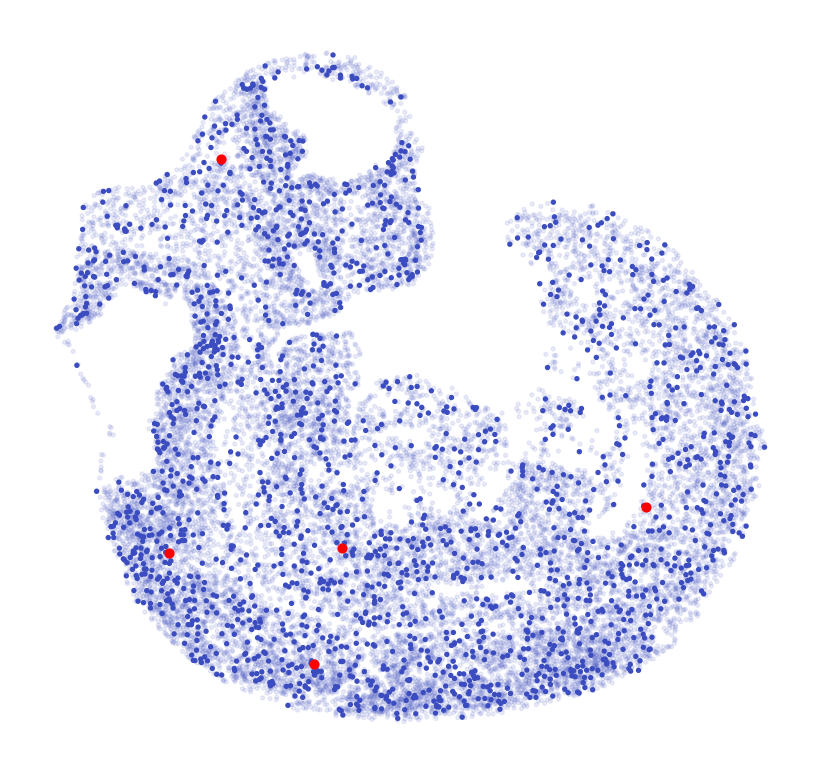

In [365]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
select_indexs = [1700, 700, 1000, 1500, 1910]
select_scalar = np.zeros((randcoordsB.shape[0],))
select_scalar[select_index] = 0.1
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][:,0],align_slices_ref[0].obsm['rotated_spatial_2D'][:,1], s=2, c=np.zeros((align_slices_ref[0].shape[0],)),alpha=0.1, cmap='coolwarm',vmin=0,vmax=1)
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx,1], s=2, c=np.zeros((randIdx.shape[0],)), cmap='coolwarm',vmin=0,vmax=1)
# ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')
for select_index in select_indexs:
    ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')
ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
plt.savefig('./figures/datapoints_converge.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

In [367]:
inter_P = inter_P.T

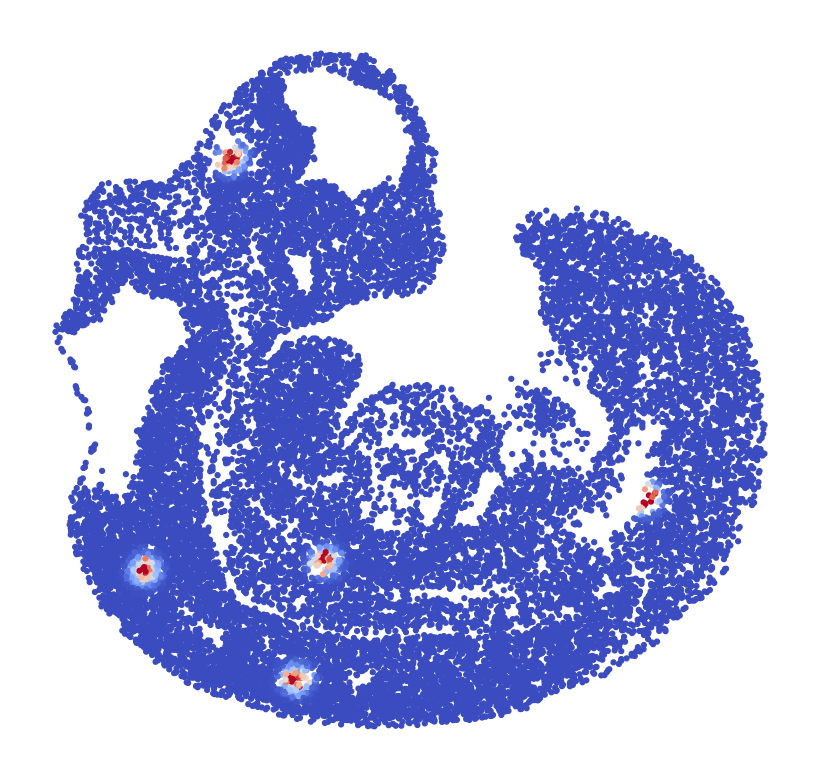

In [369]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
plot_scalar = np.zeros((inter_P.shape[1],))
for select_index in select_indexs:
    cur_scalar = inter_P[select_index,:] / -np.sort(-inter_P[select_index,:])[5]
    cur_scalar = np.minimum(cur_scalar,1)
    plot_scalar += cur_scalar
# plot_scalar = morpho_pis[0][select_index,:]
plot_sort = np.argsort(plot_scalar)
ax.scatter(align_slices_ref[1].obsm['align_spatial'][:,0],align_slices_ref[1].obsm['align_spatial'][:,1], s=3, c=plot_scalar, cmap='coolwarm', vmin=0, vmax=np.max(plot_scalar))

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
plt.savefig('./figures/modelpoints_converge.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

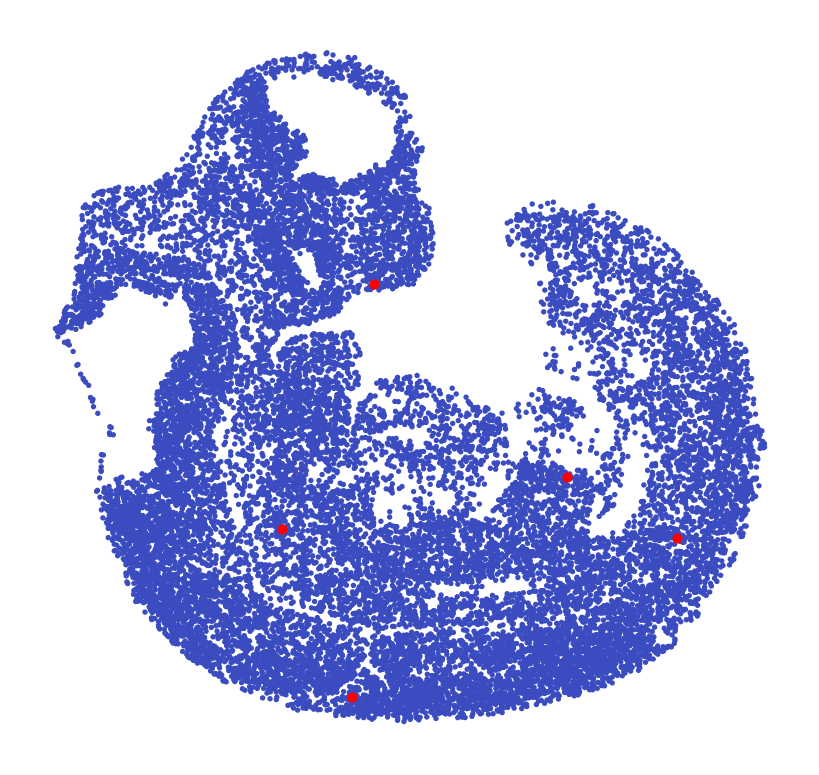

In [352]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
select_indexs = [18400, 500, 1000, 1500, 1910]
select_scalar[select_index] = 0.1
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][:,0],align_slices_ref[0].obsm['rotated_spatial_2D'][:,1], s=2, c=np.zeros((align_slices_ref[0].shape[0],)),alpha=0.1, cmap='coolwarm',vmin=0,vmax=1)
ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][:,0],align_slices_ref[0].obsm['rotated_spatial_2D'][:,1], s=2, c=np.zeros((align_slices_ref[0].shape[0],)), cmap='coolwarm',vmin=0,vmax=1)
for select_index in select_indexs:
    ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][select_index,0],align_slices_ref[0].obsm['rotated_spatial_2D'][select_index,1],s=10,c='r')

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
plt.savefig('./figures/datapoints_converge.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

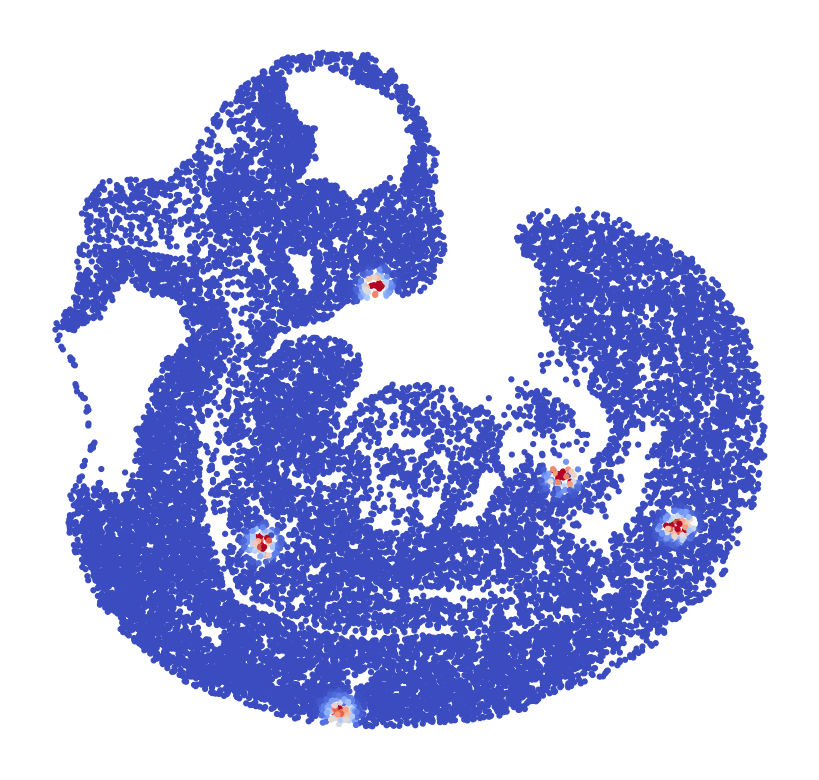

In [353]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
plot_scalar = np.zeros((morpho_pis[0].shape[1],))
for select_index in select_indexs:
    cur_scalar = morpho_pis[0][select_index,:] / -np.sort(-morpho_pis[0][select_index,:])[5]
    cur_scalar = np.minimum(cur_scalar,1)
    plot_scalar += cur_scalar
# plot_scalar = morpho_pis[0][select_index,:]
plot_sort = np.argsort(plot_scalar)
ax.scatter(align_slices_ref[1].obsm['align_spatial'][:,0],align_slices_ref[1].obsm['align_spatial'][:,1], s=3, c=plot_scalar, cmap='coolwarm', vmin=0, vmax=np.max(plot_scalar))

ax.set_facecolor('white')
ax.axis('off')
ax.set_aspect('equal')
plt.savefig('./figures/modelpoints_converge.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

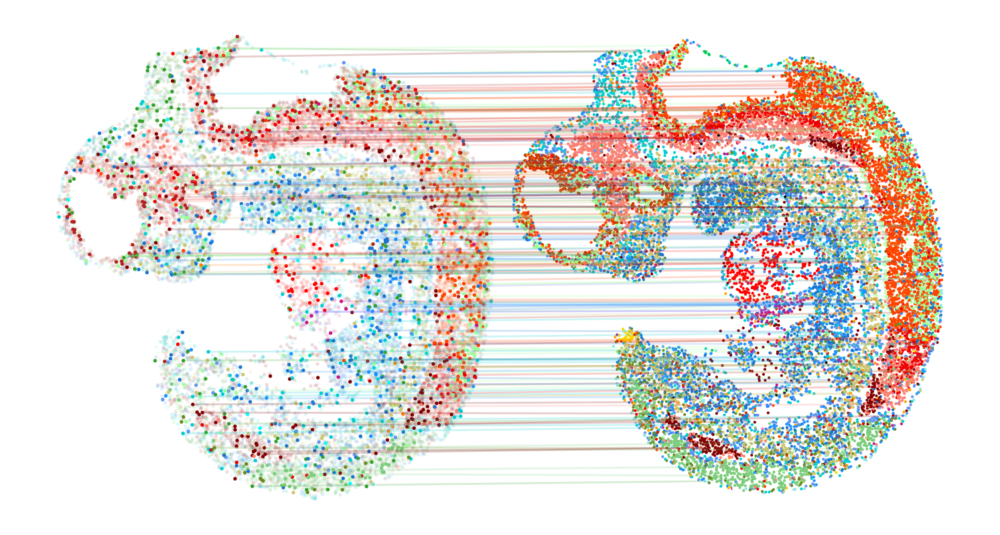

In [375]:
interval = 10000

fig, ax = plt.subplots(1,1,figsize=(10,5))

X1 = align_slices_ref[0].obsm['rotated_spatial_2D'].copy()
X1_mean = np.mean(X1)
X1 = X1 - X1_mean
theta = np.pi / 2
rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)], [np.sin(theta), np.cos(theta)]])
flip_matrix = np.array([[-1, 0], [0, 1]])
X1 = X1 @ rotation_matrix @ flip_matrix
X1 = X1 + X1_mean
# X2 = align_slices_ref[1].obsm['rotated_spatial_2D'].copy()
X2 = XAHat.copy()
X2_mean = np.mean(X2)
X2 = X2 - X2_mean
X2 = X2 @ rotation_matrix @ flip_matrix
X2 = X2 + X2_mean


label_1_ref_batch = align_slices_ref[0].obs['ctype_user'][randIdx].values
label_1_ref = align_slices_ref[0].obs['ctype_user'].values
label_2_ref = align_slices_ref[1].obs['ctype_user'].values

color_1_ref = [palette[l] for l in list(label_1_ref)]
color_2_ref = [palette[l] for l in list(label_2_ref)]
color_1_ref_batch = [palette[l] for l in list(label_1_ref_batch)]

ax.scatter(X1[:,0],X1[:,1], s=2, color=color_1_ref,alpha=0.1, )
ax.scatter(X1[randIdx,0],X1[randIdx,1], s=2, color=color_1_ref_batch, cmap='coolwarm',vmin=0,vmax=1)
# ax.scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],0],align_slices_ref[0].obsm['rotated_spatial_2D'][randIdx[select_index],1],s=10,c='r')
mapping = inter_P.T


# for i in range(mapping.shape[0]):
for i in np.random.choice(randIdx.shape[0], 200):
    # if np.sum(mapping[i]) < robust_threshold:
    #     continue
    mapping_idx = np.argmax(mapping[i])
    ax.plot(np.array([X1[randIdx[i],0], X2[mapping_idx,0]+interval]), np.array([X1[randIdx[i],1], X2[mapping_idx,1]]), color=palette[label_1_ref_batch[i]], linewidth=1, alpha=0.2)

ax.scatter(X2[:,0]+interval,X2[:,1], s=1, color=color_2_ref)

ax.set_facecolor('white')
ax.axis('off')
# ax.set_title(title)
ax.set_aspect('equal')
plt.savefig('./figures/mapping_converge.png', dpi=600, bbox_inches='tight', transparent=True)
plt.show()

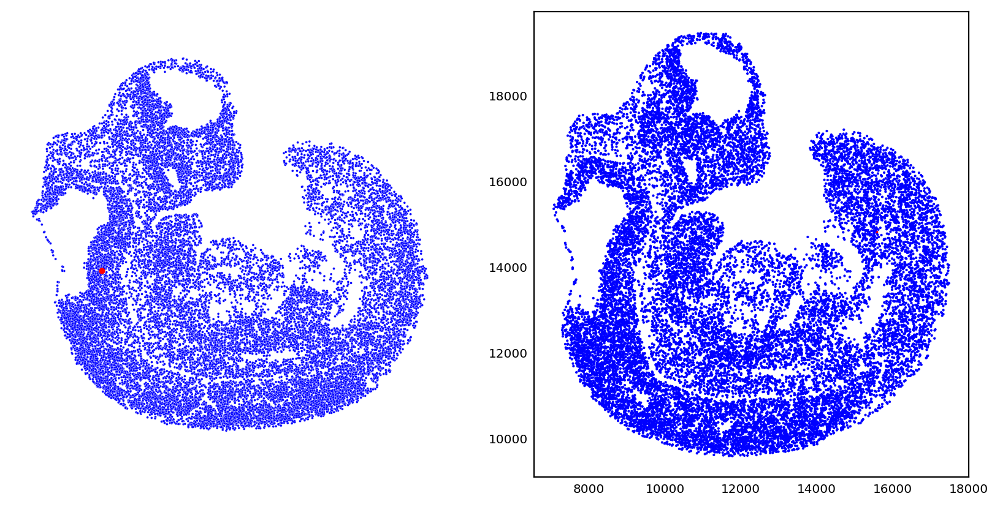

In [77]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
select_index = 100
select_scalar = np.zeros((align_slices_ref[0].shape[0],))
select_scalar[select_index] = 0.1
plot_scalar(
    align_slices_ref[0], 
    'rotated_spatial_2D',
    scalar_key=None,
    ax=axs[0],
    point_size=2,
    add_scalar = select_scalar,
    title = '',
    palette = 'bwr',
    legend=False,
    edgecolors='face',
    # v_min=0,
    # v_max=1,
    
)
axs[0].scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][select_index,0],align_slices_ref[0].obsm['rotated_spatial_2D'][select_index,1],s=10,c='r')
# plot_scalar_coords(
#     XAHat, 
#     ax=axs[1],
#     point_size=2,
#     add_scalar = inter_P[:,select_index],
#     title = '',
#     palette = 'bwr',
#     legend=False,
# )
axs[1].scatter(XAHat[:,0],XAHat[:,1], s=1, c=inter_P[:,select_index], cmap='bwr')

In [80]:
inter_P[select_index,:].shape

(2000,)

In [ ]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
select_index = 100
select_scalar = np.zeros((align_slices_ref[0].shape[0],))
select_scalar[select_index] = 0.1
plot_scalar(
    align_slices_ref[0], 
    'rotated_spatial_2D',
    scalar_key=None,
    ax=axs[0],
    point_size=2,
    add_scalar = inter_P[select_index,:],
    title = '',
    palette = 'bwr',
    legend=False,
    edgecolors='face',
    # v_min=0,
    # v_max=1,
    
)
axs[0].scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][select_index,0],align_slices_ref[0].obsm['rotated_spatial_2D'][select_index,1],s=10,c='r')
# plot_scalar_coords(
#     XAHat, 
#     ax=axs[1],
#     point_size=2,
#     add_scalar = inter_P[:,select_index],
#     title = '',
#     palette = 'bwr',
#     legend=False,
# )
axs[1].scatter(XAHat[:,0],XAHat[:,1], s=1, c=inter_P[:,select_index], cmap='bwr')

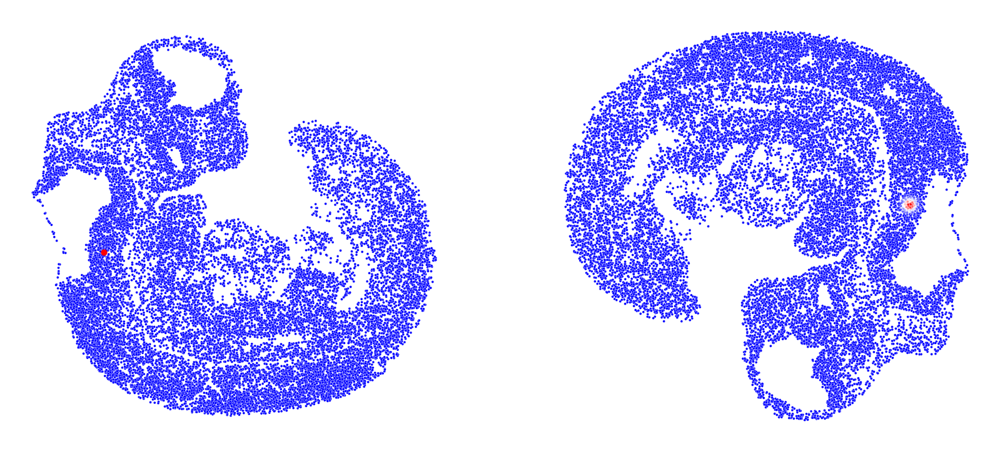

In [98]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
select_index = 100
select_scalar = np.zeros((align_slices_ref[0].shape[0],))
select_scalar[select_index] = 0.1
plot_scalar(
    align_slices_ref[0], 
    'rotated_spatial_2D',
    scalar_key=None,
    ax=axs[0],
    point_size=2,
    add_scalar = select_scalar,
    title = '',
    palette = 'bwr',
    legend=False,
    edgecolors='face',
    # v_min=0,
    # v_max=1,
    
)
axs[0].scatter(align_slices_ref[0].obsm['rotated_spatial_2D'][select_index,0],align_slices_ref[0].obsm['rotated_spatial_2D'][select_index,1],s=10,c='r')
plot_scalar(
    align_slices_ref[1], 
    'rotated_spatial_2D',
    scalar_key=None,
    ax=axs[1],
    point_size=2,
    add_scalar = morpho_pis[0][select_index,:],
    title = '',
    palette = 'bwr',
    legend=False,
)